<a href="https://colab.research.google.com/github/neclipse/Metal_defects_detection/blob/Hao-training-practice/Detectron2_video_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# install dependencies: 
!pip install pyyaml==5.1
!pip install torch==1.7.1 torchvision==0.8.2
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 5.3MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44074 sha256=40411046af4aa23d5f153c0474862ec1e162bada778d4694815ed380b8b5fc75
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
     |████████████████████████████████| 776.8MB 23kB/s 
     |████████████████████████████████| 12.8MB 61.7MB/s 
ERROR: torchtext 0.9.0 has requirement torch==1.8.0, but you'll have torch 1.7.1 which is incompatible.
  Found existing installation: torch 1.8.0+cu101
    Uninstalling torch-1.8.0+cu101:
      Successfully uninstalled torch-1.8.0+cu101
  Found existing installation: torchvision 0.9.0+cu101
    Uninstalling torchvision-0.9.0+cu101:
      Successfully uninstalled torchvision-0.9.0+cu101
1.7.1 True
gcc (Ubuntu 7.5.0-3ubun

In [2]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.7")   # need to manually install torch 1.7 if Colab changes its default version
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.8MB 3.2MB/s 
     |████████████████████████████████| 2.2MB 4.3MB/s 
     |████████████████████████████████| 51kB 7.3MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.4.post20210323-cp37-none-any.whl size=58905 sha256=8774e08f4aadfaea0317551855918a148f99a48610633be5154b6ca1b74b1b0d
  Stored in directory: /root/.cache/pip/wheels/78/70/8d/84a874a1d369396a817cec0e51962315aac32686f7752a5b3b
Successfully built fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



In [2]:
from google.colab import drive
drive.mount('/content/gdrive')
!ln -s /content/gdrive/My\ Drive/ /mydrive
!ls /mydrive/Detectron2
!cp /mydrive/Detectron2/video_train_data.zip ../
!unzip /mydrive/Detectron2/video_train_data.zip > /dev/null

Mounted at /content/gdrive
test.avi  video_train_data.zip


In [3]:
!pip install labelme2coco

In [4]:
# import package
import labelme2coco
labelme2coco.convert("video_train_data/train", "video_train_data/train/annotation_train.json")
labelme2coco.convert("video_train_data/validate", "video_train_data/validate/annotation_validate.json")

In [5]:
from detectron2.data.datasets import register_coco_instances
# args: name(str), metadata (dict): default empty, json_file_path (str), image_root (str or path like): root directory for images  
register_coco_instances("my_dataset_t", {}, "video_train_data/train/annotation_train.json", "")
register_coco_instances("my_dataset_v", {}, "video_train_data/validate/annotation_validate.json", "")

[03/23 02:59:45 d2.data.datasets.coco]: Loaded 10 images in COCO format from video_train_data/train/annotation_train.json
video_train_data/train/ZEISS XRM 620 Versa_LSU_Sample1_HR_0p7um_.tif0271.png


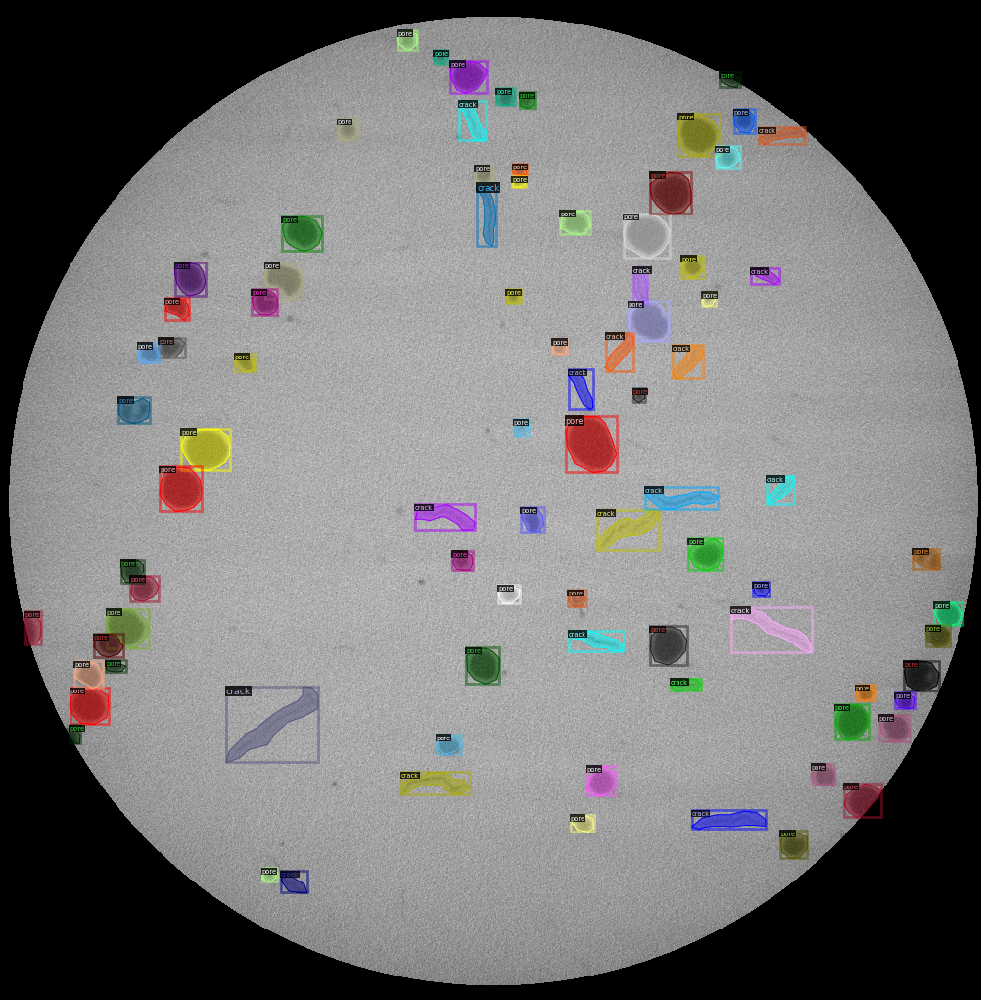

video_train_data/train/ZEISS XRM 620 Versa_LSU_Sample1_HR_0p7um_.tif1621.png


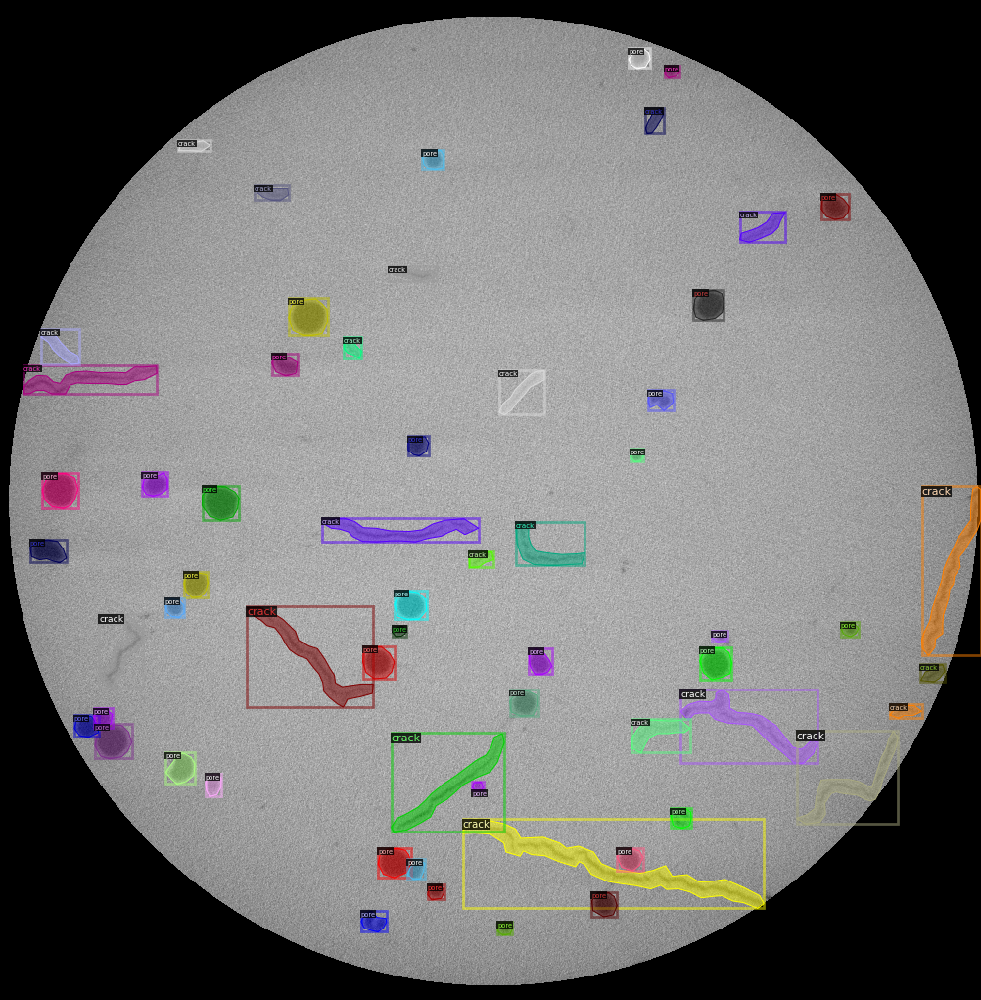

video_train_data/train/ZEISS XRM 620 Versa_LSU_Sample1_HR_0p7um_.tif1221.png


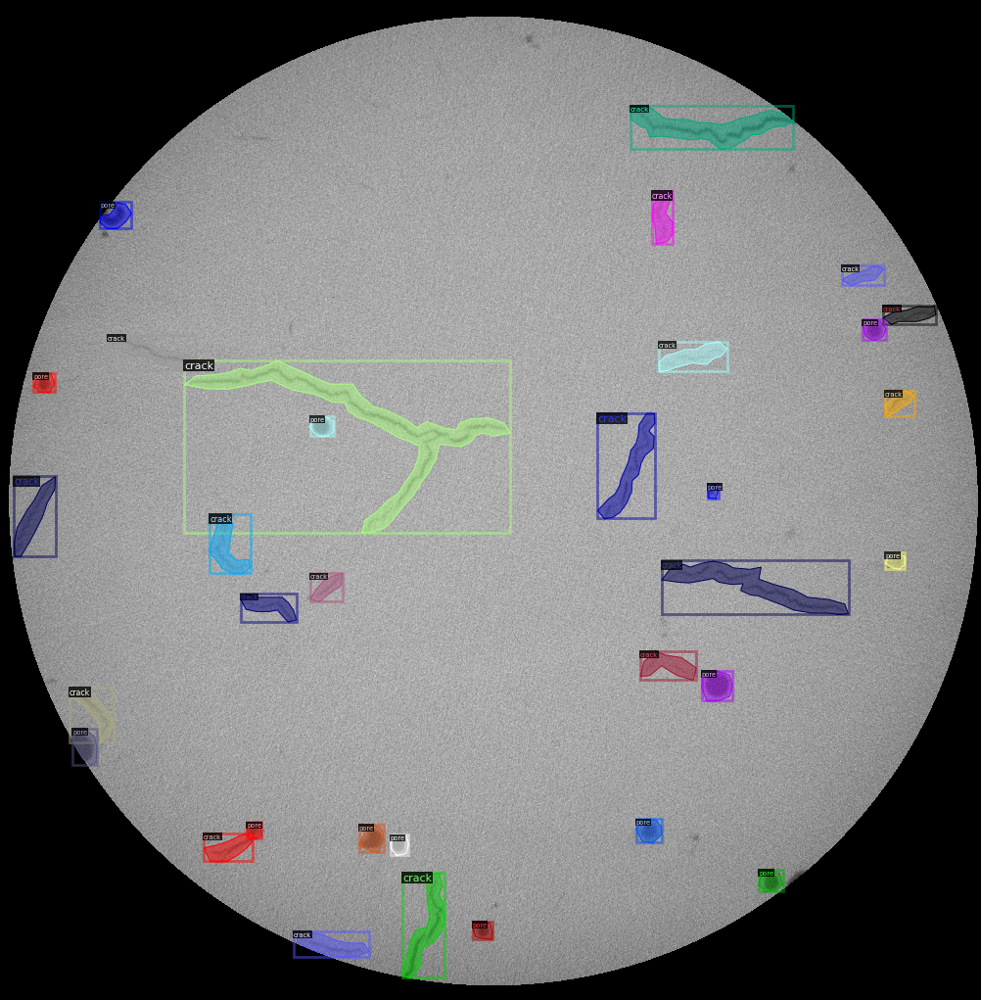

In [6]:
dataset_dict=DatasetCatalog.get("my_dataset_t")
mymetadata=MetadataCatalog.get("my_dataset_t")
#dataset_dicts = get_balloon_dicts("balloon/train")
for d in random.sample(dataset_dict, 3):
    print(d["file_name"])
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=mymetadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

In [7]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_DC5_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_t",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_DC5_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025  # pick a good LR
cfg.SOLVER.MAX_ITER = 5000   # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # two classes(crack and pore)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=True)
trainer.train()

[03/23 03:00:18 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_0464b7.pkl: 766MB [00:53, 14.3MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[03/23 03:01:14 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/

[03/23 03:01:32 d2.utils.events]:  eta: 1:14:16  iter: 19  total_loss: 3.467  loss_cls: 0.9591  loss_box_reg: 0.6232  loss_mask: 0.6898  loss_rpn_cls: 0.9365  loss_rpn_loc: 0.2289  time: 0.8963  data_time: 0.0205  lr: 4.9952e-05  max_mem: 6648M
[03/23 03:01:50 d2.utils.events]:  eta: 1:13:08  iter: 39  total_loss: 2.293  loss_cls: 0.7021  loss_box_reg: 0.664  loss_mask: 0.6497  loss_rpn_cls: 0.07975  loss_rpn_loc: 0.1785  time: 0.8814  data_time: 0.0043  lr: 9.9902e-05  max_mem: 6648M
[03/23 03:02:07 d2.utils.events]:  eta: 1:12:12  iter: 59  total_loss: 1.977  loss_cls: 0.5439  loss_box_reg: 0.6906  loss_mask: 0.5632  loss_rpn_cls: 0.05735  loss_rpn_loc: 0.1593  time: 0.8733  data_time: 0.0040  lr: 0.00014985  max_mem: 6648M
[03/23 03:02:24 d2.utils.events]:  eta: 1:11:55  iter: 79  total_loss: 1.757  loss_cls: 0.4179  loss_box_reg: 0.6666  loss_mask: 0.4584  loss_rpn_cls: 0.04979  loss_rpn_loc: 0.1511  time: 0.8742  data_time: 0.0043  lr: 0.0001998  max_mem: 6648M
[03/23 03:02:42 d2.

In [8]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [9]:
# cfg already contains everything we've set previously. Now we changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3   # set a custom testing threshold
cfg.TEST.DETECTIONS_PER_IMAGE = 100
predictor = DefaultPredictor(cfg)

[03/23 04:22:22 d2.data.datasets.coco]: Loaded 4 images in COCO format from video_train_data/validate/annotation_validate.json
video_train_data/validate/ZEISS XRM 620 Versa_LSU_Sample1_HR_0p7um_.tif0721.png


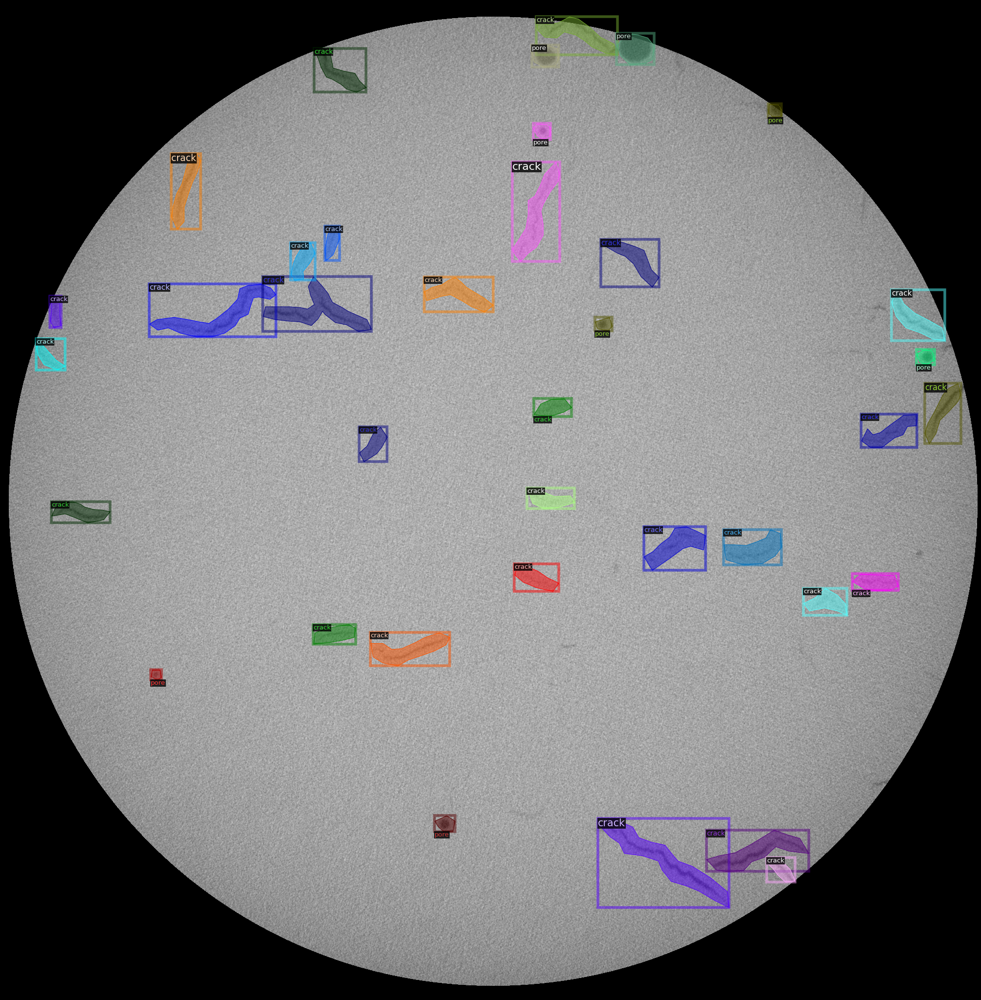

video_train_data/validate/ZEISS XRM 620 Versa_LSU_Sample1_HR_0p7um_.tif1081.png


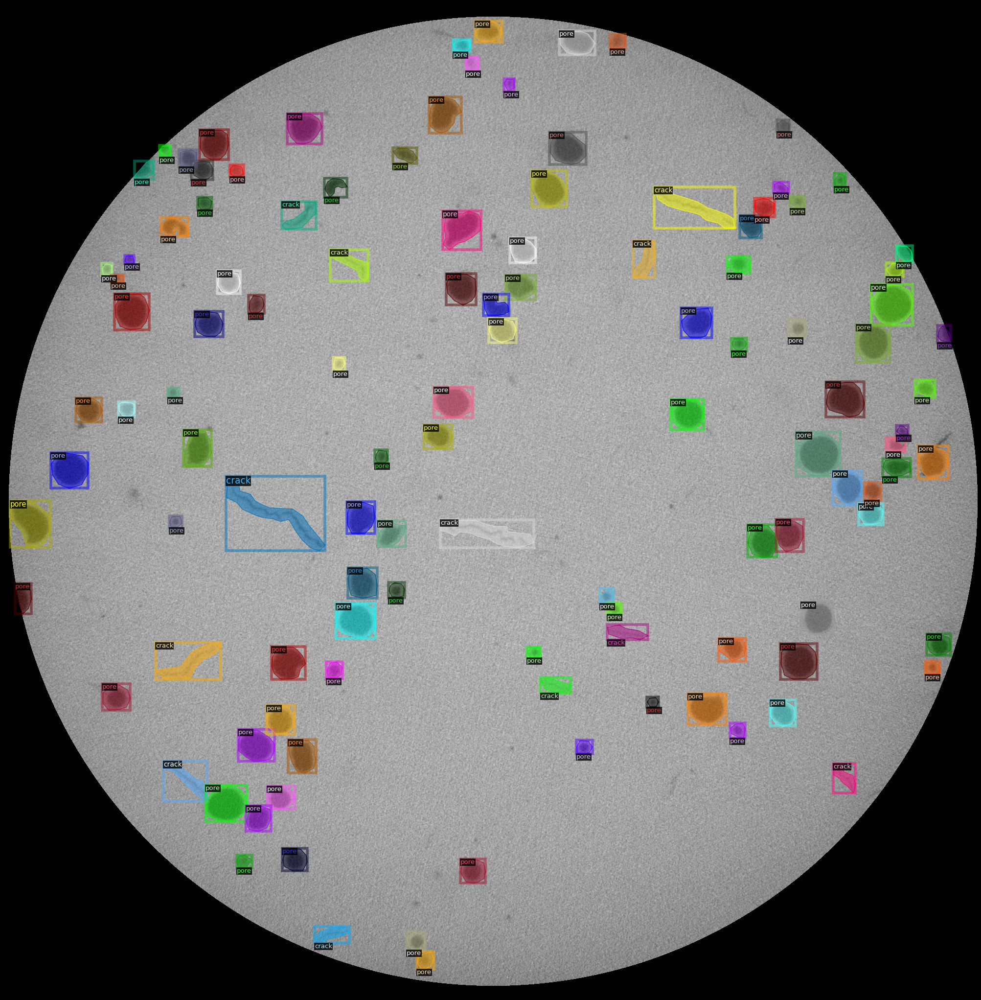

In [10]:
dataset_dict2=DatasetCatalog.get("my_dataset_v")
mymetadata2=MetadataCatalog.get("my_dataset_v")
#dataset_dicts = get_balloon_dicts("balloon/train")
for d in random.sample(dataset_dict2, 2):
    print(d["file_name"])
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=mymetadata2, scale=1)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

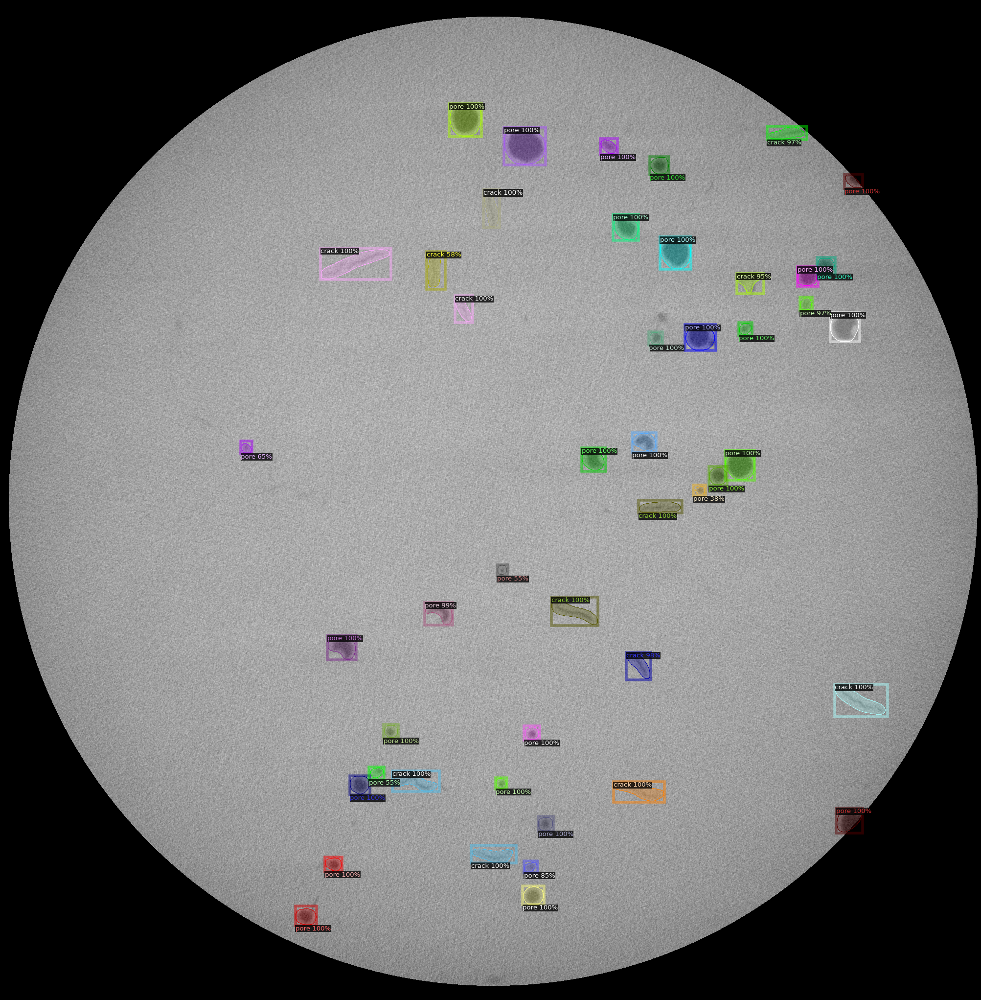

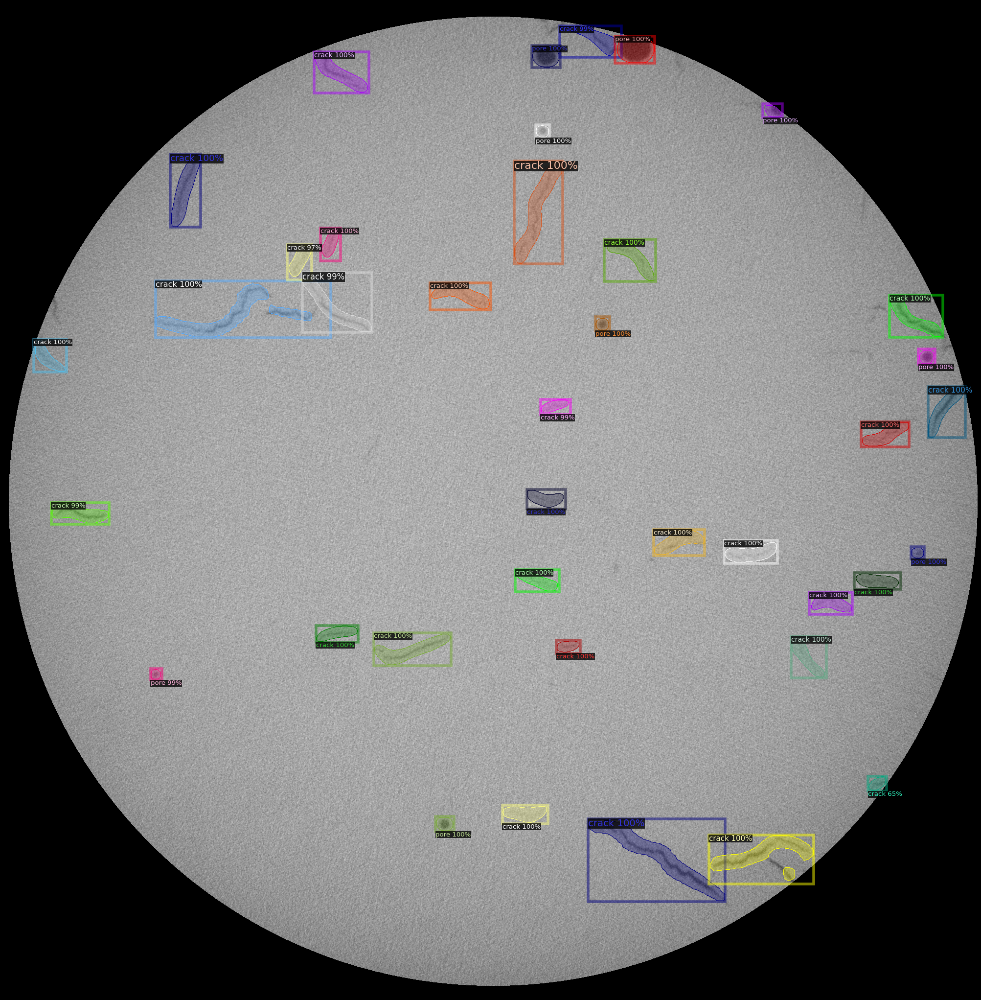

In [11]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = dataset_dict2
for d in random.sample(dataset_dicts, 2):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=mymetadata2, 
                   scale=1, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [13]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("my_dataset_v", ("bbox", "segm"), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_v")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[03/23 04:24:32 d2.data.datasets.coco]: Loaded 4 images in COCO format from video_train_data/validate/annotation_validate.json
[03/23 04:24:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/23 04:24:32 d2.data.common]: Serializing 4 elements to byte tensors and concatenating them all ...
[03/23 04:24:32 d2.data.common]: Serialized dataset takes 0.07 MiB
[03/23 04:24:32 d2.evaluation.evaluator]: Start inference on 4 images
[03/23 04:24:36 d2.evaluation.evaluator]: Total inference time: 0:00:01.208203 (1.208203 s / img per device, on 1 devices)
[03/23 04:24:36 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.223566 s / img per device, on 1 devices)
[03/23 04:24:36 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/23 04:24:36 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[03/23 04:24:

In [ ]:
#!/usr/bin/env python3
# -- coding: utf-8 --

import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
# import some common libraries
import numpy as np
import tqdm
import cv2
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.video_visualizer import VideoVisualizer
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2.data import MetadataCatalog
import time

# Extract video properties
video = cv2.VideoCapture('gdrive/MyDrive/Detectron2/test.avi')
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames_per_second = video.get(cv2.CAP_PROP_FPS)
num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# Initialize video writer
video_writer = cv2.VideoWriter('out.mp4', fourcc=cv2.VideoWriter_fourcc(*"mp4v"), fps=float(frames_per_second), frameSize=(width, height), isColor=True)

# Initialize predictor
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3   # set a custom testing threshold
cfg.TEST.DETECTIONS_PER_IMAGE = 1000
predictor = DefaultPredictor(cfg)

# Initialize visualizer
v = VideoVisualizer(MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), ColorMode.IMAGE)

def runOnVideo(video, maxFrames):
    """ Runs the predictor on every frame in the video (unless maxFrames is given),
    and returns the frame with the predictions drawn.
    """

    readFrames = 0
    while True:
        hasFrame, frame = video.read()
        if not hasFrame:
            break

        # Get prediction results for this frame
        outputs = predictor(frame)

        # Make sure the frame is colored
        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

        # Draw a visualization of the predictions using the video visualizer
        visualization = v.draw_instance_predictions(frame, outputs["instances"].to("cpu"))

        # Convert Matplotlib RGB format to OpenCV BGR format
        visualization = cv2.cvtColor(visualization.get_image(), cv2.COLOR_RGB2BGR)

        yield visualization

        readFrames += 1
        if readFrames > maxFrames:
            break

# Create a cut-off for debugging
#num_frames = 10

# Enumerate the frames of the video
for visualization in tqdm.tqdm(runOnVideo(video, num_frames), total=num_frames):

    # Write test image
    cv2.imwrite('POSE detectron2.png', visualization)

    # Write to video file
    video_writer.write(visualization)

# Release resources
video.release()
video_writer.release()
cv2.destroyAllWindows()

100%|██████████| 100/100 [04:38<00:00,  2.78s/it]
